## Imports

In [1]:
import sys
from utils.loading import load_table
import matplotlib.pyplot as plt
import pandas as pd
import datetime
import numpy as np
import time
import tensorflow as tf
from sklearn.preprocessing import StandardScaler
from tensorflow.keras import regularizers

2023-05-03 15:11:08.176329: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Tables Dict


In [2]:
# Dictionary of 'table_name' -> []'patient', 'datetime']
tables = {
    'Meter': ['DeidentID', 'DataDtTm'],
    'CGM': ['DeidentID', 'DisplayTime'],
    'CGMCal': ['DeidentID', 'DisplayTime'],
    'Ketone': ['DeidentID', 'DataDtTm'],
    'MonitorBasalBolus': ['DeidentID', 'LocalDeliveredDtTm'],
    'MonitorCGM': ['DeidentID', 'LocalDtTmAdjusted'],
    'MonitorCorrectionBolus': ['DeidentID', 'LocalDeliveredDtTm'],
    'MonitorMeal': ['DeidentID', 'LocalDtTm'],
    'MonitorMealBolus': ['DeidentID', 'LocalDeliveredDtTm'],
    'MonitorSMBG': ['DeidentID','LocalDtTm'],
    'MonitorSystem': ['DeidentID','LocalDtTm'],
    'MonitorTotalBolus': ['DeidentID', 'LocalDeliveredDtTm'],
    'Pump': ['DeidentID', 'DataDtTm'],
}

GROUP_DATES = True

## Select Patient

In [3]:
DeidentId = '11'

## Load Relevant Tables

In [4]:
df_MonitorBasalBolus = load_table(filename='MonitorBasalBolus', date_cols=tables['MonitorBasalBolus'])
df_MonitorCGM = load_table(filename='MonitorCGM', date_cols=tables['MonitorCGM'])
df_MonitorCorrectionBolus = load_table(filename='MonitorCorrectionBolus', date_cols=tables['MonitorCorrectionBolus'])
df_MonitorMeal = load_table(filename='MonitorMeal', date_cols=tables['MonitorMeal'])
df_MonitorMealBolus = load_table(filename='MonitorMealBolus', date_cols=tables['MonitorMealBolus'])
df_MonitorSMBG = load_table(filename='MonitorSMBG', date_cols=tables['MonitorSMBG'])
df_MonitorSystem = load_table(filename='MonitorSystem', date_cols=tables['MonitorSystem'])
df_MonitorTotalBolus = load_table(filename='MonitorTotalBolus', date_cols=tables['MonitorTotalBolus'])
# filter by patient
df_MonitorBasalBolus = df_MonitorBasalBolus[df_MonitorBasalBolus['DeidentID'] == DeidentId]
df_MonitorCGM = df_MonitorCGM[df_MonitorCGM['DeidentID'] == DeidentId]
df_MonitorCorrectionBolus = df_MonitorCorrectionBolus[df_MonitorCorrectionBolus['DeidentID'] == DeidentId]
df_MonitorMeal = df_MonitorMeal[df_MonitorMeal['DeidentID'] == DeidentId]
df_MonitorMealBolus = df_MonitorMealBolus[df_MonitorMealBolus['DeidentID'] == DeidentId]
df_MonitorSMBG = df_MonitorSMBG[df_MonitorSMBG['DeidentID'] == DeidentId]
df_MonitorSystem = df_MonitorSystem[df_MonitorSystem['DeidentID'] == DeidentId]
df_MonitorTotalBolus = df_MonitorTotalBolus[df_MonitorTotalBolus['DeidentID'] == DeidentId]

## Remove unnecessary entries

In [5]:
df_MonitorBasalBolus = df_MonitorBasalBolus[['LocalDeliveredDtTm', 'DeliveredValue']]
df_MonitorCGM = df_MonitorCGM[['LocalDtTm', 'CGM']]
df_MonitorCorrectionBolus = df_MonitorCorrectionBolus[['LocalDeliveredDtTm', 'BolusSource', 'DeliveredValue']]
df_MonitorMeal = df_MonitorMeal[['LocalDtTm', 'MealSize', 'SMBG']]
df_MonitorMealBolus = df_MonitorMealBolus[['LocalDeliveredDtTm', 'DeliveredValue']]
df_MonitorSMBG = df_MonitorSMBG[df_MonitorSMBG['IsCalibration'] == 0]
df_MonitorSMBG = df_MonitorSMBG[['LocalDtTm', 'SMBG', 'IsHypo', 'DidTreat', 'Carbs']]
df_MonitorSystem = df_MonitorSystem[['LocalDtTm', 'DiAsState', 'IOBValue', 'Hypolight', 'Hyperlight', 'Exercising']]
df_MonitorTotalBolus = df_MonitorTotalBolus[['LocalDeliveredDtTm', 'DeliveredValue']]

## Standardize Naming

In [6]:
df_MonitorCorrectionBolus['LocalDtTm'] = df_MonitorCorrectionBolus['LocalDeliveredDtTm']
df_MonitorMealBolus['LocalDtTm'] = df_MonitorMealBolus['LocalDeliveredDtTm']
df_MonitorTotalBolus['LocalDtTm'] = df_MonitorTotalBolus['LocalDeliveredDtTm']
df_MonitorBasalBolus['LocalDtTm'] = df_MonitorBasalBolus['LocalDeliveredDtTm']
df_MonitorCorrectionBolus.drop(columns=['LocalDeliveredDtTm'], inplace=True)
df_MonitorMealBolus.drop(columns=['LocalDeliveredDtTm'], inplace=True)
df_MonitorTotalBolus.drop(columns=['LocalDeliveredDtTm'], inplace=True)
df_MonitorBasalBolus.drop(columns=['LocalDeliveredDtTm'], inplace=True)

## Function to get last two meals prior to a given time

In [7]:
def get_last_two_meals(df_MonitorMeal, time):
    df_MonitorMeal = df_MonitorMeal[df_MonitorMeal['LocalDtTm'] < time]
    df_MonitorMeal = df_MonitorMeal.sort_values(by='LocalDtTm', ascending=False)
    df_MonitorMeal = df_MonitorMeal.head(2)
    #check if there are two meals
    if len(df_MonitorMeal) < 2:
        return (0, 0, 0, 0)
    return (df_MonitorMeal['MealSize'].iloc[0], df_MonitorMeal['LocalDtTm'].iloc[0], df_MonitorMeal['MealSize'].iloc[1], df_MonitorMeal['LocalDtTm'].iloc[1])


## Function to get last two SMBG carb loads prior to a given time

In [8]:
def get_last_two_carbs(df_MonitorSMBG, time):
    df_MonitorSMBG = df_MonitorSMBG[df_MonitorSMBG['LocalDtTm'] < time]
    df_MonitorSMBG = df_MonitorSMBG[df_MonitorSMBG['Carbs'] > 0]
    df_MonitorSMBG = df_MonitorSMBG.sort_values(by='LocalDtTm', ascending=False)
    df_MonitorSMBG = df_MonitorSMBG.head(2)
    # check if last two carbs are present
    if len(df_MonitorSMBG) < 2:
        return (0, 0, 0, 0)
    return (df_MonitorSMBG['Carbs'].iloc[0], df_MonitorSMBG['LocalDtTm'].iloc[0], df_MonitorSMBG['Carbs'].iloc[1], df_MonitorSMBG['LocalDtTm'].iloc[1])

## Function to get last exercise start and end time prior to a given time

In [9]:
def get_last_exercise_start(df_MonitorSystem, time):
    df_MonitorSystem = df_MonitorSystem[df_MonitorSystem['LocalDtTm'] < time]
    first_exercisetime = df_MonitorSystem[df_MonitorSystem['Exercising'] == 1]
    first_exercisetime = first_exercisetime.sort_values(by='LocalDtTm', ascending=False)
    first_exercisetime = first_exercisetime.head(1)
    #check if there is an exercise time
    if len(first_exercisetime) < 1:
        return (-1, -1)
    first_exercisetime = first_exercisetime['LocalDtTm'].values[0]
    exercise_endtime = df_MonitorSystem[df_MonitorSystem['Exercising'] == 0]
    exercise_endtime = exercise_endtime[exercise_endtime['LocalDtTm'] < first_exercisetime]
    exercise_endtime = exercise_endtime.sort_values(by='LocalDtTm', ascending=False)
    exercise_endtime = exercise_endtime.head(1)
    exercise_endtime = exercise_endtime['LocalDtTm'].values[0]
    return first_exercisetime, exercise_endtime

## Create one large insuline DataFrame

In [10]:
df_Insulin = pd.concat([df_MonitorBasalBolus, df_MonitorCorrectionBolus, df_MonitorMealBolus])
df_Insulin = df_Insulin.sort_values(by='LocalDtTm', ascending=True)
df_Insulin = df_Insulin.reset_index(drop=True)
df_Insulin = df_Insulin[['LocalDtTm', 'DeliveredValue']]

## Function to get insulin intake over last hour grouped by 5-minute intervals prior to a given time

In [11]:
def get_last_hour_insulin(df, date):
    # filter the dataframe to keep only the rows within the past 24 hours
    df = df[df['LocalDtTm'] >= date - pd.Timedelta(days=1)]

    # round the datetime to the nearest 5-minute interval
    df['LocalDtTm'] = df['LocalDtTm'].dt.floor('5min')
    # group the rows by 5-minute intervals and compute the sum of the DeliveredValue column for each group
    agg_df = df.groupby('LocalDtTm')['DeliveredValue'].sum()

    # create a list of 288 values with 0 for any missing intervals
    date_range = pd.date_range(date - pd.Timedelta(days=1), date, freq='5min')
    date_range = date_range.floor('5min')
    #reverse the list
    date_range = date_range[::-1]

    result = [agg_df.get(date, default=0) for date in date_range]
    result = result[:288]
    if len(result) < 288:
        result = result + [0] * (288 - len(result))
    return result

In [13]:
#test get_last_hour_insulin
print(df_Insulin.tail(10))
date = pd.to_datetime('2013-05-19 19:08:37')
print(get_last_hour_insulin(df_Insulin, date))

                LocalDtTm  DeliveredValue
30287 2013-05-19 16:13:37             0.1
30288 2013-05-19 16:18:37             0.1
30289 2013-05-19 16:28:37             0.1
30290 2013-05-19 16:38:37             0.1
30291 2013-05-19 16:48:37             0.1
30292 2013-05-19 17:03:37             0.1
30293 2013-05-19 17:48:36             0.1
30294 2013-05-19 18:48:36             0.1
30295 2013-05-19 18:58:37             0.1
30296 2013-05-19 19:08:37             0.1
[0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.1000000014901161, 0, 0, 0, 0, 0, 0, 0, 0, 0.1000000014901161, 0, 0, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0, 0.1000000014901161, 0, 0, 0.1000000014901161, 0, 0, 0.1000000014901161, 0, 0, 

/var/folders/xr/6ct67hxs5fb52kg937_mkzcw0000gn/T/ipykernel_72934/568924000.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['LocalDtTm'] = df['LocalDtTm'].dt.floor('5min')


## Final DataFrame creation

In [14]:
df_final = pd.DataFrame()
df_final['LocalDtTm'] = df_MonitorCGM['LocalDtTm']
df_final['CGM'] = df_MonitorCGM['CGM']
df_tuples = df_final['LocalDtTm'].apply(lambda x: get_last_two_meals(df_MonitorMeal, x))
df_final[['meal_1_size', 'meal_1_time', 'meal_2_size', 'meal_2_time']] = pd.DataFrame(df_tuples.tolist(), index=df_final.index)
print('last two meals added')
df_tuples = df_final['LocalDtTm'].apply(lambda x: get_last_two_carbs(df_MonitorSMBG, x))
df_final[['carb_1','carb_1_time', 'carb_2', 'carb_2_time']] = pd.DataFrame(df_tuples.tolist(), index=df_final.index)
print('last two carbs added')
df_tuples = df_final['LocalDtTm'].apply(lambda x: get_last_exercise_start(df_MonitorSystem, x))
df_final[['exercise_end', 'exercise_start']] = pd.DataFrame(df_tuples.tolist(), index=df_final.index)
print('last exercise added')
df_final['LocalDtTm'] = pd.to_datetime(df_final['LocalDtTm'])
new_df = df_final['LocalDtTm'].apply(lambda x: pd.Series(get_last_hour_insulin(df_Insulin, x)))
print('last hour insulin added')
new_df.columns = [f"diabetes {i}" for i in range(1, 289)]


last two meals added
last two carbs added
last exercise added


/var/folders/xr/6ct67hxs5fb52kg937_mkzcw0000gn/T/ipykernel_72934/568924000.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['LocalDtTm'] = df['LocalDtTm'].dt.floor('5min')
/var/folders/xr/6ct67hxs5fb52kg937_mkzcw0000gn/T/ipykernel_72934/568924000.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['LocalDtTm'] = df['LocalDtTm'].dt.floor('5min')
/var/folders/xr/6ct67hxs5fb52kg937_mkzcw0000gn/T/ipykernel_72934/568924000.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

last hour insulin added


In [15]:
df_final = pd.concat([df_final, new_df], axis=1)
df_final = df_final.dropna()
df_final = df_final.reset_index(drop=True)
df_final['LocalDtTm'] = pd.to_datetime(df_final['LocalDtTm'])
df_final['meal_1_time'] = pd.to_datetime(df_final['meal_1_time'])
df_final['meal_2_time'] = pd.to_datetime(df_final['meal_2_time'])
df_final['carb_1_time'] = pd.to_datetime(df_final['carb_1_time'])
df_final['carb_2_time'] = pd.to_datetime(df_final['carb_2_time'])
df_final['exercise_end'] = pd.to_datetime(df_final['exercise_end'])
df_final['exercise_start'] = pd.to_datetime(df_final['exercise_start'])
df_final['meal_1_time'] = df_final['LocalDtTm'] - df_final['meal_1_time']
df_final['meal_2_time'] = df_final['LocalDtTm'] - df_final['meal_2_time']
df_final['carb_1_time'] = df_final['LocalDtTm'] - df_final['carb_1_time']
df_final['carb_2_time'] = df_final['LocalDtTm'] - df_final['carb_2_time']
df_final['exercise_end'] = df_final['LocalDtTm'] - df_final['exercise_end']
df_final['exercise_start'] = df_final['LocalDtTm'] - df_final['exercise_start']
df_final['meal_1_time'] = df_final['meal_1_time'].apply(lambda x: x.total_seconds())
df_final['meal_2_time'] = df_final['meal_2_time'].apply(lambda x: x.total_seconds())
df_final['carb_1_time'] = df_final['carb_1_time'].apply(lambda x: x.total_seconds())
df_final['carb_2_time'] = df_final['carb_2_time'].apply(lambda x: x.total_seconds())
df_final['exercise_end'] = df_final['exercise_end'].apply(lambda x: x.total_seconds())
df_final['exercise_start'] = df_final['exercise_start'].apply(lambda x: x.total_seconds())
df_final['exercise_duration'] = df_final['exercise_end'] - df_final['exercise_start']
df_final = df_final.drop(['exercise_end'], axis=1)
#sort by local time reversed
df_final = df_final.sort_values(by='LocalDtTm', ascending=True)

In [20]:
print(df_final.head())

              LocalDtTm  CGM  meal_1_size   meal_1_time  meal_2_size   
829 2012-07-15 15:16:10  228            0  1.342365e+09            0  \
828 2012-07-15 15:21:10  225            0  1.342366e+09            0   
827 2012-07-15 15:26:10  226            0  1.342366e+09            0   
826 2012-07-15 15:31:10  227            0  1.342366e+09            0   
825 2012-07-15 15:36:10  230            0  1.342367e+09            0   

      meal_2_time  carb_1   carb_1_time  carb_2   carb_2_time  ...   
829  1.342365e+09     0.0  1.342365e+09     0.0  1.342365e+09  ...  \
828  1.342366e+09     0.0  1.342366e+09     0.0  1.342366e+09  ...   
827  1.342366e+09     0.0  1.342366e+09     0.0  1.342366e+09  ...   
826  1.342366e+09     0.0  1.342366e+09     0.0  1.342366e+09  ...   
825  1.342367e+09     0.0  1.342367e+09     0.0  1.342367e+09  ...   

     diabetes 280  diabetes 281  diabetes 282  diabetes 283  diabetes 284   
829           0.0           0.0           0.0           0.0          

## Save the final DataFrame

In [126]:
df_final.to_csv(f'df_final_{DeidentId}.csv', index=False)

## Build and Train Neural Network

2023-05-03 15:33:37.183488: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Epoch 1/100
461/461 [==============================] - 2s 2ms/step - loss: 10174.8369 - mae: 83.7750 - val_loss: 3974.1553 - val_mae: 50.9781
Epoch 2/100
461/461 [==============================] - 1s 2ms/step - loss: 5986.3325 - mae: 61.9109 - val_loss: 3112.0649 - val_mae: 44.1228
Epoch 3/100
461/461 [==============================] - 1s 2ms/step - loss: 5587.4556 - mae: 59.5284 - val_loss: 3352.9160 - val_mae: 45.9307
Epoch 4/100
461/461 [==============================] - 1s 1ms/step - loss: 5263.4810 - mae: 57.6853 - val_loss: 2784.2004 - val_mae: 41.2473
Epoch 5/100
461/461 [==============================] - 1s 1ms/step - loss: 4902.2998 - mae: 55.3823 - val_loss: 2694.9272 - val_mae: 40.3055
Epoch 6/100
461/461 [==============================] - 1s 2ms/step - loss: 4692.5229 - mae: 54.1240 - val_loss: 2973.3945 - val_mae: 42.4604
Epoch 7/100
461/461 [==============================] - 1s 2ms/step - loss: 4564.0103 - mae: 53.2476 - val_loss: 2426.7576 - val_mae: 37.9406
Epoch 8/100


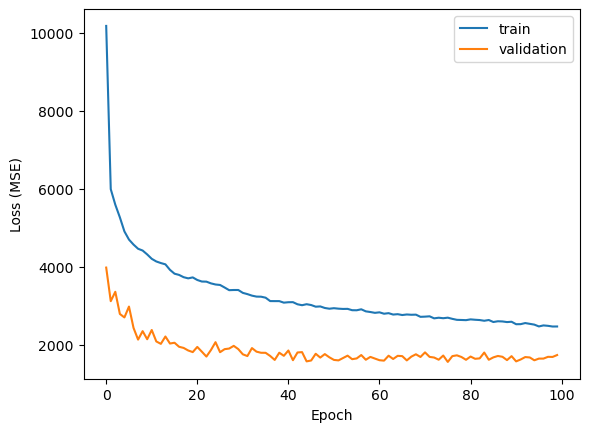

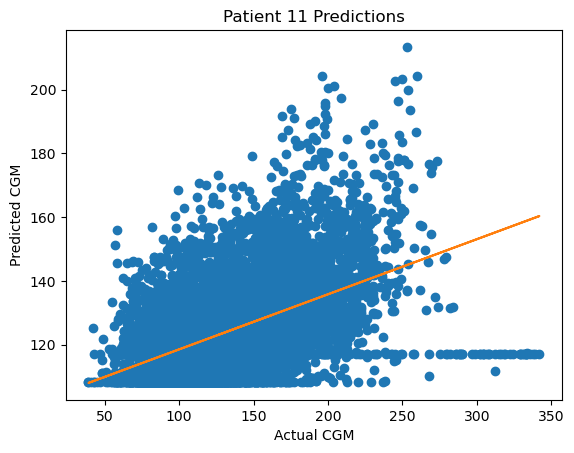

In [21]:
X = df_final.drop(columns='CGM')
X = X.drop(columns='LocalDtTm')
y = df_final['CGM']

# Split the data into training and testing sets
X_train = X[:int(0.8 * len(X))]
X_test = X[int(0.8 * len(X)):]
y_train = y[:int(0.8 * len(y))]
y_test = y[int(0.8 * len(y)):]

# Standardize the input features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define L2 regularization with a lambda value
l2_lambda = 0.01
l2_regularizer = regularizers.l2(l2_lambda)

dropout_rate = 0.5

# Step 3: Build the neural network model
# Build the neural network model with L2 regularization and dropout
model = tf.keras.Sequential([
    tf.keras.layers.Dense(50, activation='relu', input_shape=(X_train_scaled.shape[1],), kernel_regularizer=l2_regularizer),
    tf.keras.layers.Dropout(dropout_rate),
    tf.keras.layers.Dense(40, activation='relu', kernel_regularizer=l2_regularizer),
    tf.keras.layers.Dropout(dropout_rate),
    tf.keras.layers.Dense(30, activation='relu', kernel_regularizer=l2_regularizer),
    tf.keras.layers.Dropout(dropout_rate),
    tf.keras.layers.Dense(15, activation='relu', kernel_regularizer=l2_regularizer),
    tf.keras.layers.Dropout(dropout_rate),
    tf.keras.layers.Dense(1)
])

# Compile the model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

# Step 4: Train the model
history = model.fit(X_train_scaled, y_train, epochs=100, validation_split=0.3, batch_size=64)

# Step 5: Evaluate the model
test_loss, test_mae = model.evaluate(X_test_scaled, y_test)
print("Test Mean Absolute Error (MAE):", test_mae)

# Step 6: Make predictions
y_pred = model.predict(X_test_scaled)
y_pred = y_pred.flatten()

# Step 7: Plot the learning curve
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='validation')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.show()

# Step 8: Plot the predictions vs actual
plt.plot(y_test, y_pred, 'o')
plt.xlabel('Actual CGM')
plt.ylabel('Predicted CGM')
# add correlation line to plot
m, b = np.polyfit(y_test, y_pred, 1)
plt.plot(y_test, m*y_test + b)
#set title to patient 2 predictions
plt.title(f'Patient {DeidentId} Predictions')
#save plot
plt.savefig(f'patient_{DeidentId}_predictions.png')
plt.show()